[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1fKnA6gzqpZlCjpBkaLfPPxlp8rouI6Gz)

# 1) Prepare annotated images of xml using labelimg

# 2) Clone, install, and test the TensorFlow Object Detection API

In [1]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 74, done.
remote: Counting objects: 100% (74/74), done.
remote: Compressing objects: 100% (69/69), done.
remote: Total 51779 (delta 30), reused 38 (delta 5), pack-reused 51705
Receiving objects: 100% (51779/51779), 568.98 MiB | 37.45 MiB/s, done.
Resolving deltas: 100% (35337/35337), done.


In [2]:
%cd /content/models/research/
!protoc object_detection/protos/*.proto --python_out=.

# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/models/research
Processing /content/models/research
     |████████████████████████████████| 9.0MB 6.6MB/s 
     |████████████████████████████████| 358kB 55.2MB/s 
     |████████████████████████████████| 1.1MB 54.5MB/s 
     |████████████████████████████████| 61kB 9.4MB/s 
     |████████████████████████████████| 829kB 57.2MB/s 
     |████████████████████████████████| 153kB 56.0MB/s 
     |████████████████████████████████| 17.7MB 215kB/s 
     |████████████████████████████████| 51kB 9.0MB/s 
     |████████████████████████████████| 2.2MB 51.7MB/s 
     |████████████████████████████████| 61kB 9.2MB/s 
     |████████████████████████████████| 102kB 15.3MB/s 
     |████████████████████████████████| 51kB 9.1MB/s 
     |████████████████████████████████| 174kB 59.4MB/s 
     |████████████████████████████████| 645kB 46.7MB/s 
     |████████████████████████████████| 1.2MB 46.8MB/s 
     |████████████████████████████████| 706kB 49.1MB/s 
     |████████████████████████████████| 37.6MB 80kB/

In [3]:
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

2021-02-14 09:34:12.170475: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Running tests under Python 3.6.9: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-02-14 09:34:15.014761: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-14 09:34:15.015745: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-14 09:34:15.075688: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-14 09:34:15.076304: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB devic

# 3) Get the images & Process them

In [4]:
cd ../..

/content


In [5]:
%%bash

# Clone dataset from existing repository
git clone https://github.com/azzubair01/invoice-dataset.git

# Move the contents repository to their specific locations
mv /content/invoice-dataset/dataset /content/
mv /content/invoice-dataset/label_map.pbtxt /content/
mv /content/invoice-dataset/invoice_labels_train.csv /content/

# Unzip the images
cd dataset
unzip train.zip
mv train images

Archive:  train.zip
   creating: train/
  inflating: train/Invoice_1.jpg     
  inflating: train/Invoice_10.jpg    
  inflating: train/Invoice_100.jpg   
  inflating: train/Invoice_100_affine_translation.jpg  
  inflating: train/Invoice_100_brightness.jpg  
  inflating: train/Invoice_100_gaussianblur.jpg  
  inflating: train/Invoice_100_horizontallyflip.jpg  
  inflating: train/Invoice_101.jpg   
  inflating: train/Invoice_101_affine_translation.jpg  
  inflating: train/Invoice_101_brightness.jpg  
  inflating: train/Invoice_101_gaussianblur.jpg  
  inflating: train/Invoice_101_horizontallyflip.jpg  
  inflating: train/Invoice_102.jpg   
  inflating: train/Invoice_102_affine_translation.jpg  
  inflating: train/Invoice_102_brightness.jpg  
  inflating: train/Invoice_102_gaussianblur.jpg  
  inflating: train/Invoice_102_horizontallyflip.jpg  
  inflating: train/Invoice_103.jpg   
  inflating: train/Invoice_103_affine_translation.jpg  
  inflating: train/Invoice_103_brightness.jpg  
  in

Cloning into 'invoice-dataset'...


In [6]:
import os
import numpy as np
import shutil
import random
import glob

# # Creating Train / Val / Test folders (One time use)
dataset_dir = '/content/dataset/'
image_dir = 'images/'

val_ratio = 0.15
test_ratio = 0.05

# Creating directories for train, val, & test
myFileList = glob.glob1(dataset_dir + image_dir,"*.jpg")
print("\nThere are",len(myFileList),"images read by Python")
np.random.shuffle(myFileList)

os.makedirs(dataset_dir + image_dir + 'train')
os.makedirs(dataset_dir + image_dir + 'val')
os.makedirs(dataset_dir + image_dir + 'test')

# Creating partitions of the data after shuffeling
np.random.shuffle(myFileList)
train_FileNames, val_FileNames, test_FileNames = np.split(np.array(myFileList),
                                                          [int(len(myFileList)* (1 - val_ratio + test_ratio)), 
                                                           int(len(myFileList)* (1 - test_ratio))])
train_FileNames = [dataset_dir + image_dir + name for name in train_FileNames.tolist()]
val_FileNames = [dataset_dir + image_dir + name for name in val_FileNames.tolist()]
test_FileNames = [dataset_dir + image_dir + name for name in test_FileNames.tolist()]
print('Total images: ', len(myFileList))
print('Training: ', len(train_FileNames))
print('Validation: ', len(val_FileNames))
print('Testing: ', len(test_FileNames))

# Copy-pasting images
for name in train_FileNames:
    shutil.copy(name, dataset_dir + image_dir +'/train')
for name in val_FileNames:
    shutil.copy(name, dataset_dir + image_dir + '/val')
for name in test_FileNames:
    shutil.copy(name, dataset_dir + image_dir + '/test')

# Remove images not in their specific directories
for file in os.listdir(dataset_dir + image_dir):
    if file.endswith('.jpg'):
        os.remove(dataset_dir + image_dir + file)

# Generate csv files for train, val, & test
import pandas as pd
labels_df = pd.read_csv('invoice_labels_train.csv')
train_images_path = os.listdir(dataset_dir + image_dir + '/train')
val_images_path   = os.listdir(dataset_dir + image_dir + '/val')
test_images_path  = os.listdir(dataset_dir + image_dir + '/test')

# Split invoice_labels_train.csv into train_labels, val_labels, & test_labels
from tqdm import tqdm
train_list = []
val_list = []
test_list = []

for i in tqdm(range(len(labels_df))):
    for j in range(len(train_images_path)):
        if labels_df['filename'][i] == train_images_path[j]:
            train_list.append(labels_df.iloc[i][:])
    for j in range(len(val_images_path)):
        if labels_df['filename'][i] == val_images_path[j]:
            val_list.append(labels_df.iloc[i][:]) 
    for j in range(len(test_images_path)):
        if labels_df['filename'][i] == test_images_path[j]:
            test_list.append(labels_df.iloc[i][:]) 

# Convert lists to dataframes
train_df = pd.DataFrame(train_list)  
val_df   = pd.DataFrame(val_list)
test_df  = pd.DataFrame(test_list)

# Save dataframes as csv files
train_df.to_csv(dataset_dir +'/train_labels.csv', index=False)
val_df.to_csv  (dataset_dir +'/val_labels.csv'  , index=False) 
test_df.to_csv (dataset_dir +'test_labels.csv' , index=False)

print('Successfully splitted images into train, val, & test')

  0%|          | 0/6040 [00:00<?, ?it/s]


There are 965 images read by Python
Total images:  965
Training:  868
Validation:  48
Testing:  49


100%|██████████| 6040/6040 [00:30<00:00, 198.52it/s]


Successfully splitted images into train, val, & test


# 4) Generate TF Records of images

In [7]:
%cd /content/
!python dataset/generate_tf_records.py -l /content/label_map.pbtxt -o dataset/train.record -i dataset/images/train -csv dataset/train_labels.csv
!python dataset/generate_tf_records.py -l /content/label_map.pbtxt -o dataset/val.record -i dataset/images/val -csv dataset/val_labels.csv
!python dataset/generate_tf_records.py -l /content/label_map.pbtxt -o dataset/test.record -i dataset/images/test -csv dataset/test_labels.csv

/content
2021-02-14 09:36:33.238950: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
INFO:Successfully created the TFRecords: dataset/train.record
2021-02-14 09:36:36.654713: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
INFO:Successfully created the TFRecords: dataset/val.record
2021-02-14 09:36:38.889286: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
INFO:Successfully created the TFRecords: dataset/test.record


# 5) Choose & download the object detection model

In [8]:
%cd /content

## Choose any suitable object_detection models from download.tensorflow.org/models/object_detection/tf2/20200711

# !wget download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
# !tar -xvf faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
# !rm faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz
# !mv faster_rcnn_resnet50_v1_640x640_coco17_tpu-8 frcnn_v1

# !wget download.tensorflow.org/models/object_detection/tf2/20200711/centernet_resnet50_v2_512x512_coco17_tpu-8.tar.gz
# !tar -xvf centernet_resnet50_v2_512x512_coco17_tpu-8.tar.gz
# !rm centernet_resnet50_v2_512x512_coco17_tpu-8.tar.gz
# !mv centernet_resnet50_v2_512x512_coco17_tpu-8 resnet_v2

!wget download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
!tar -xvf efficientdet_d0_coco17_tpu-32.tar.gz
!rm efficientdet_d0_coco17_tpu-32.tar.gz
!mv efficientdet_d0_coco17_tpu-32 efficient_d0

/content
--2021-02-14 09:36:46--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.20.128, 2607:f8b0:400e:c08::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.20.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30736482 (29M) [application/x-tar]
Saving to: ‘efficientdet_d0_coco17_tpu-32.tar.gz’

efficientdet_d0_coc 100%[===================>]  29.31M   133MB/s    in 0.2s    

2021-02-14 09:36:46 (133 MB/s) - ‘efficientdet_d0_coco17_tpu-32.tar.gz’ saved [30736482/30736482]

efficientdet_d0_coco17_tpu-32/
efficientdet_d0_coco17_tpu-32/checkpoint/
efficientdet_d0_coco17_tpu-32/checkpoint/ckpt-0.data-00000-of-00001
efficientdet_d0_coco17_tpu-32/checkpoint/checkpoint
efficientdet_d0_coco17_tpu-32/checkpoint/ckpt-0.index
efficientdet_d0_coco17_tpu-32/pipeline.config
efficientdet_d0_coco17_tpu-32/saved_model/
efficie

In [9]:
## Download specific configurations from the selected model above from https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2

# !wget https://github.com/tensorflow/models/blob/master/research/object_detection/configs/tf2/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.config
# !mv faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.config frcnn_v1.config

# !wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/centernet_resnet50_v2_512x512_kpts_coco17_tpu-8.config
# !mv centernet_resnet50_v2_512x512_kpts_coco17_tpu-8.config resnet_v2.config

!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
!mv ssd_efficientdet_d0_512x512_coco17_tpu-8.config efficient_d0.config

--2021-02-14 09:36:52--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4630 (4.5K) [text/plain]
Saving to: ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’

ssd_efficientdet_d0 100%[===================>]   4.52K  --.-KB/s    in 0s      

2021-02-14 09:36:52 (70.0 MB/s) - ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’ saved [4630/4630]



# 6) Configure the training model

In [10]:
num_classes = 2
batch_size = 7
num_steps = 7500
num_eval_steps = 1000
checkpoint_type = 'detection'

train_record_path = '/content/dataset/train.record'
test_record_path = '/content/dataset/val.record'
model_dir = '/content/training/'
labelmap_path = '/content/label_map.pbtxt'

# pipeline_config_path = '/content/frcnn_v1/pipeline.config'
# fine_tune_checkpoint = '/content/frcnn_v1/checkpoint/ckpt-0'

# pipeline_config_path = '/content/resnet_v2.config'
# fine_tune_checkpoint = '/content/resnet_v2/checkpoint/ckpt-0'

pipeline_config_path = '/content/efficient_d0.config'
fine_tune_checkpoint = '/content/efficient_d0/checkpoint/ckpt-0'

In [11]:
import re

with open(pipeline_config_path) as f:
    config = f.read()

with open(pipeline_config_path, 'w') as f:

  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
             'label_map_path: "{}"'.format(labelmap_path), config)
  
  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), config)
  
  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                  'input_path: "{}"'.format(train_record_path), config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  'input_path: "{}"'.format(test_record_path), config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(num_classes), config)
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)
  
  # Set checkpoint type
  config = re.sub('fine_tune_checkpoint_type: "classification"',
                  'fine_tune_checkpoint_type: "{}"'.format(checkpoint_type), config)
  
  f.write(config)


# 7) Train the model

In [12]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2021-02-14 09:37:46.337897: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-14 09:37:48.767663: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-14 09:37:48.768565: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-14 09:37:48.798040: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-14 09:37:48.798731: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-14 09:37:48.798769: I tensorflow/stream_executor/platform/default/dso_loade

# 8) Validate the model

In [13]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir}

2021-02-14 11:25:18.809664: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
W0214 11:25:21.166601 139863779911552 model_lib_v2.py:1034] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0214 11:25:21.166788 139863779911552 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0214 11:25:21.166884 139863779911552 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0214 11:25:21.166963 139863779911552 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0214 11:25:21.167072 139863779911552 model_lib_v2.py:1049] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-02-14 11:25:21.175336: I tensorflow/compiler/jit/xla

# 9) Visualize results in Tensorboard

In [14]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/'

<IPython.core.display.Javascript object>

# 10) Exporting the model

In [15]:
with open('/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/utils/tf_utils.py') as f:
    tf_utils = f.read()

with open('/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/utils/tf_utils.py', 'w') as f:
  # Set labelmap path
  throw_statement = "raise TypeError('Expected Operation, Variable, or Tensor, got ' + str(x))"
  tf_utils = tf_utils.replace(throw_statement, "if not isinstance(x, str):" + throw_statement)
  f.write(tf_utils)

In [16]:
output_directory = 'inference_graph'

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2021-02-14 11:34:31.041233: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-14 11:34:33.221476: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-14 11:34:33.222330: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-14 11:34:33.251835: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-14 11:34:33.252429: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-14 11:34:33.252466: I tensorflow/stream_executor/platform/default/dso_loade

In [17]:
!zip -r /content/saved_model.zip /content/inference_graph/saved_model/

  adding: content/inference_graph/saved_model/ (stored 0%)
  adding: content/inference_graph/saved_model/assets/ (stored 0%)
  adding: content/inference_graph/saved_model/variables/ (stored 0%)
  adding: content/inference_graph/saved_model/variables/variables.index (deflated 77%)
  adding: content/inference_graph/saved_model/variables/variables.data-00000-of-00001 (deflated 36%)
  adding: content/inference_graph/saved_model/saved_model.pb (deflated 93%)


In [18]:
from google.colab import files
files.download("/content/saved_model.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### Model development ends here. You may use the downloaded saved_models and use invoice_efficient_d0_test notebook on local machine for prediction. If you want to use the saved models in colab, you may proceed onwards.

# 11) Testing the model

In [19]:
!wget https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
from inferenceutils import *

--2021-02-14 11:39:17--  https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2219 (2.2K) [text/plain]
Saving to: ‘inferenceutils.py’

inferenceutils.py   100%[===================>]   2.17K  --.-KB/s    in 0s      

2021-02-14 11:39:18 (38.9 MB/s) - ‘inferenceutils.py’ saved [2219/2219]



In [20]:
%%bash
unzip /content/saved_model.zip

Archive:  /content/saved_model.zip
   creating: content/inference_graph/saved_model/
   creating: content/inference_graph/saved_model/assets/
   creating: content/inference_graph/saved_model/variables/
  inflating: content/inference_graph/saved_model/variables/variables.index  
  inflating: content/inference_graph/saved_model/variables/variables.data-00000-of-00001  
  inflating: content/inference_graph/saved_model/saved_model.pb  


In [21]:
output_directory = 'inference_graph/'
import tensorflow as tf
from object_detection.utils import label_map_util
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/{output_directory}/saved_model')

In [24]:
import pandas as pd
test = pd.read_csv('dataset/test_labels.csv')
#Getting 3 random images to test
images = list(test.sample(n=3)['filename'])
images

['Invoice_116.jpg',
 'Invoice_39_horizontallyflip.jpg',
 'Invoice_75_gaussianblur.jpg']

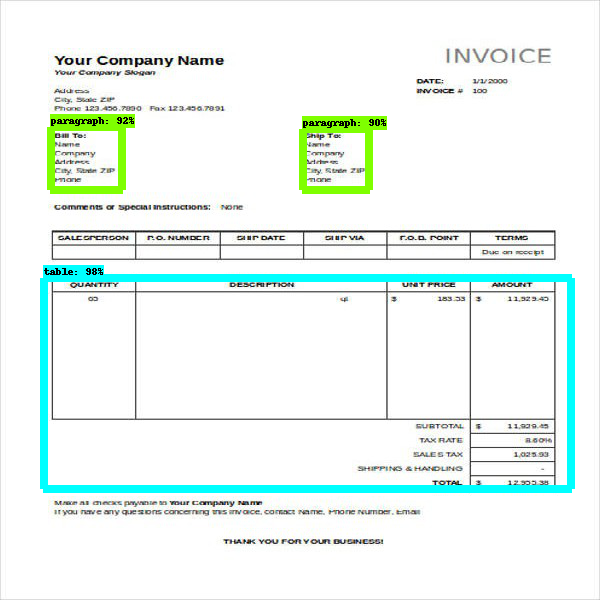

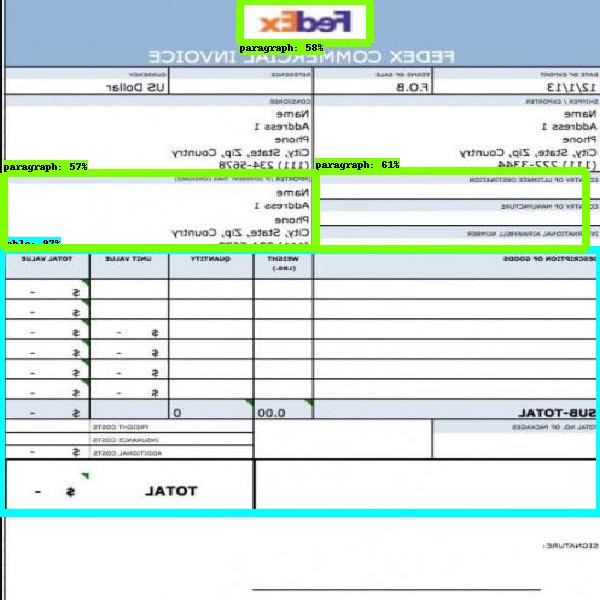

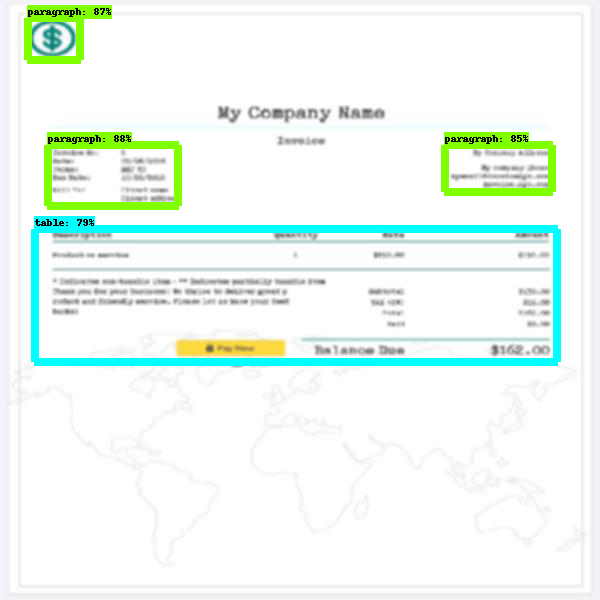

In [26]:
for image_name in images:
  
  image_np = load_image_into_numpy_array('dataset/images/test/' + image_name)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))



----------